# Base Model
-----------------
This notebook was used to create a baseline GAN model. The objective was to use a standard DCGAN, based off the TF DCGAN tutorial, which we could use as a comparison to the GANSFORMER model.

In [8]:
# #######
# Requirements for working with Tensorflow Docker, I'm not sure if this is required
# for Google Colab. At least it is here if needed.
# #######

# !pip install seaborn pandas opencv-python tqdm
# !apt-get update 
# !apt-get install ffmpeg libsm6 libxext6  -y

In [14]:
import os
import warnings
import glob
import time
import math

from PIL import Image
from tqdm import tqdm
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy import linalg
import cv2

import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.applications.inception_v3 import preprocess_input

from IPython import display

In [10]:
# Plot and Jupyter Config
%matplotlib inline
%config InlineBackend.figure_format='retina'
warnings.filterwarnings('ignore')

In [11]:
# Check GPU Access
print(f'GPU : {tf.config.list_physical_devices("GPU")}')

GPU : [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [12]:
# Set TF settings
AUTOTUNE = tf.data.AUTOTUNE

-------------------
## Import Data Path and Meta

In [13]:
# Import the three different datasets
col_names = ['path', 'class', 'xmin' ,'ymin' ,'xmax', 'ymax']

df_train = pd.read_csv(
    os.path.join('data', 'train_COVIDx_CT-2A.txt'), 
    names=col_names,
    header=None, delimiter=r'\s+'
)

df_test = pd.read_csv(
    os.path.join('data', 'test_COVIDx_CT-2A.txt'), 
    names=col_names,
    header=None, delimiter=r'\s+'
)

df_val = pd.read_csv(
    os.path.join('data', 'val_COVIDx_CT-2A.txt'), 
    names=col_names,
    header=None, delimiter=r'\s+'
)

FileNotFoundError: [Errno 2] No such file or directory: 'data/train_COVIDx_CT-2A.txt'

Instead of confusing the GAN with scans from multiple diseases, lets start out by limiting this to only normal scans. We can always change this later.

In [8]:
# Select category one they are normal scans
# temp_train = df_train.loc[df_train['class'] == 0]
# temp_test = df_test.loc[df_test['class'] == 0]
# temp_val = df_val.loc[df_val['class'] == 0]

# Adjust for full data
temp_train = df_train
temp_test = df_test
temp_val = df_val

# Merge to one set for GAN
data_df = pd.concat([temp_train, temp_test, temp_val], ignore_index=True)

In [9]:
data_df.describe()

,class,xmin,ymin,xmax,ymax
count,194922.000000,194922.000000,194922.000000,194922.000000,194922.000000
mean,1.176814,25.638625,112.343763,489.299638,425.960010
std,0.872948,24.373200,41.234890,34.778494,37.978286
min,0.000000,0.000000,0.000000,125.000000,224.000000
25%,0.000000,0.000000,84.000000,470.000000,404.000000
50%,1.000000,22.000000,110.000000,490.000000,423.000000
75%,2.000000,42.000000,139.000000,512.000000,442.000000
max,2.000000,198.000000,421.000000,1168.000000,949.000000


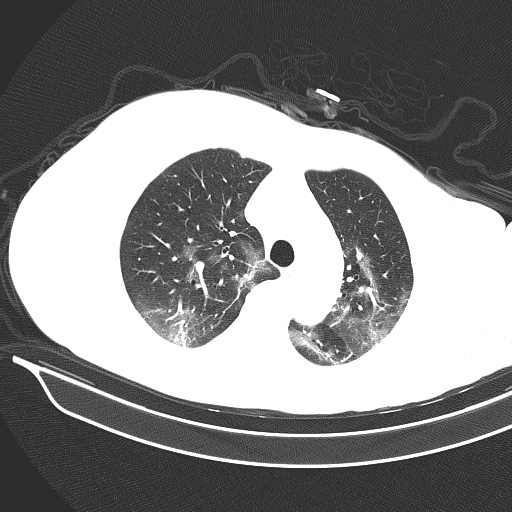

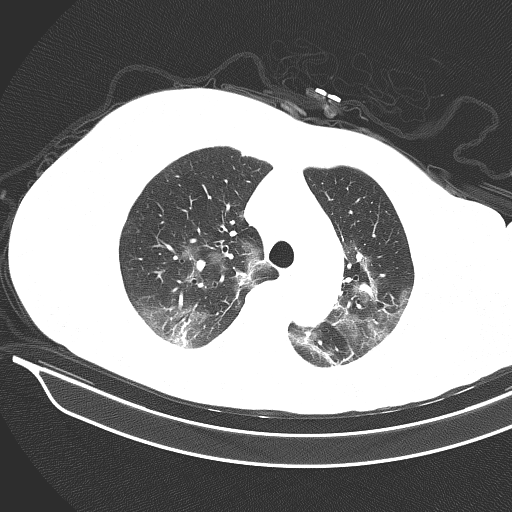

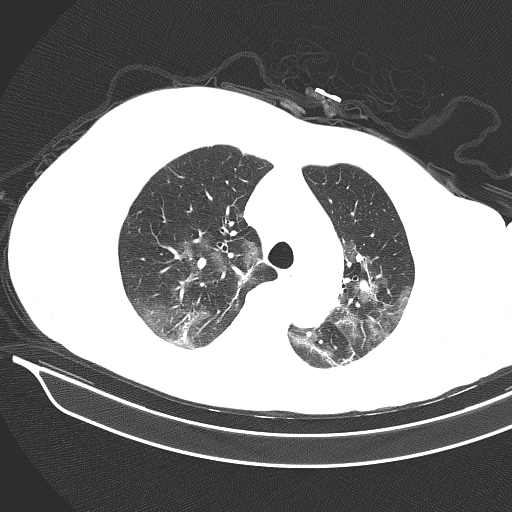

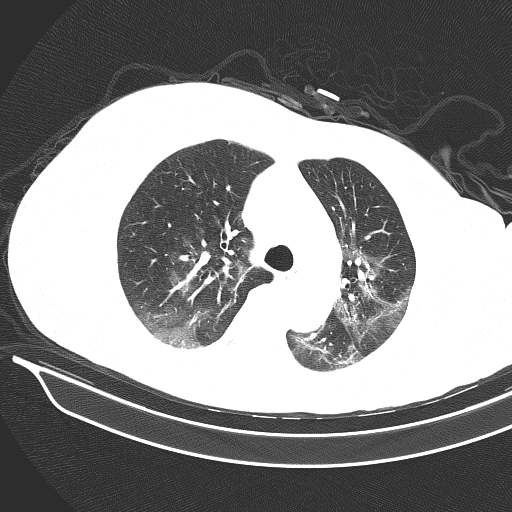

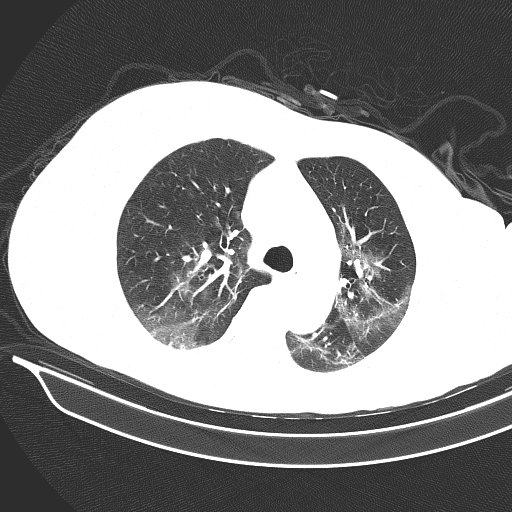

...

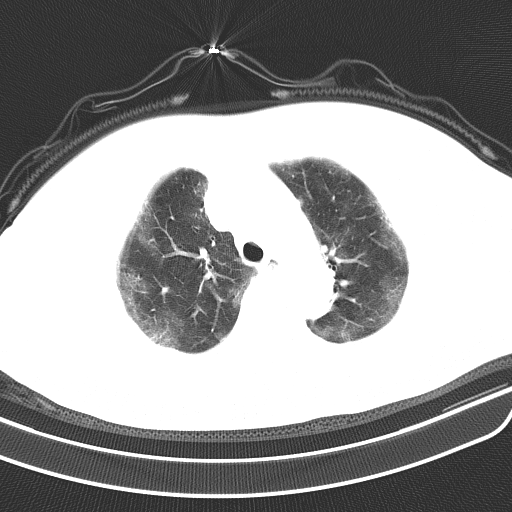

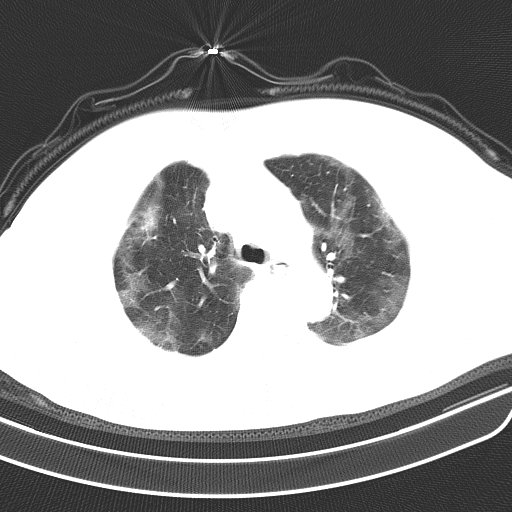

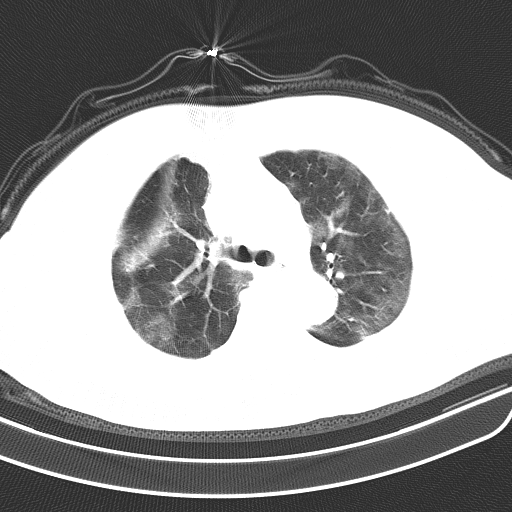

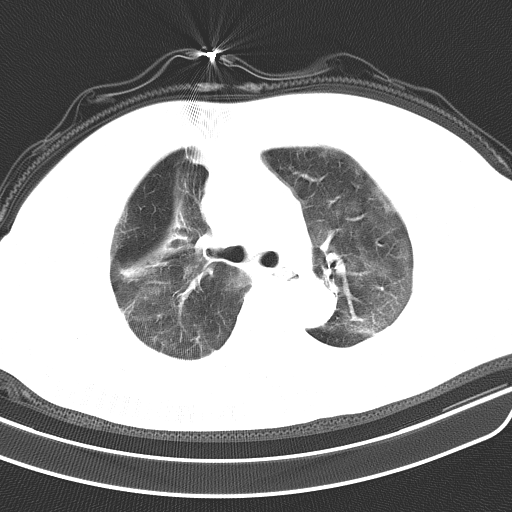

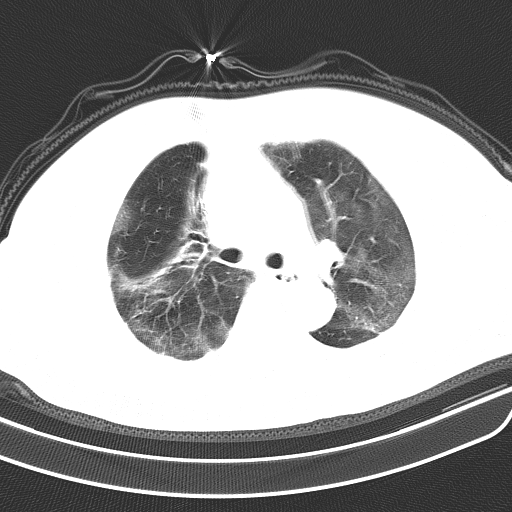

In [10]:
for path in data_df.path[10000:10030]:
    path = os.path.join('data', '2A_images', path)
    
    img = Image.open(path)
    img.show()

These images are in a sequence of slices over a single subject. We will have to see how this impacts the GAN. 

---------------
## Create TF Dataset


In [11]:
# Append true path for reference
paths = [os.path.join('data','2A_images', x) for x in data_df.path]

In [12]:
# Dataset Config
IMG_SIZE = 256
BATCH_SIZE = 64
BUFFER_SIZE = data_df.shape[0]

# Util functions for mapping 
def get_proc_img(path):
    """
    Load images, decode png, and then resize them to the defined
    image size. We also later standardized the images between [-1, 1]
    so that we could use a tanh activation to stablize the training.
    """
    img = tf.io.read_file(path)
    img = tf.image.decode_png(img)
    img = tf.image.resize(img, [IMG_SIZE, IMG_SIZE])
    
    # Might need to adjust this later
    img = (img - 127.5) / 127.5
    
    return img

train = tf.data.Dataset.from_tensor_slices(paths)
train = train.shuffle(buffer_size=BUFFER_SIZE)
train = train.map(get_proc_img, num_parallel_calls=AUTOTUNE)
train = train.batch(BATCH_SIZE)
train_set = train.prefetch(AUTOTUNE)

In [13]:
train_set

<PrefetchDataset shapes: (None, 256, 256, None), types: tf.float32>

(64, 256, 256, 1)


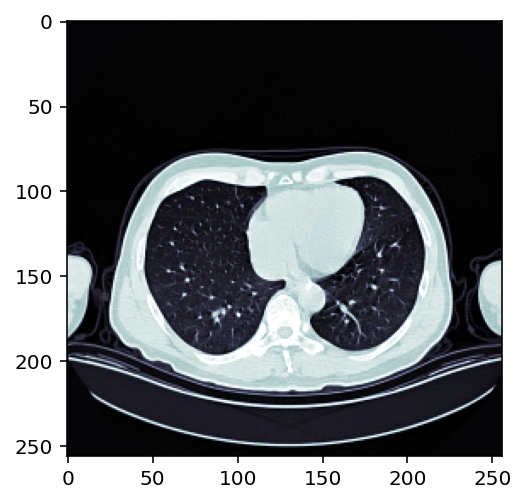

In [14]:
# Take one will return a batch
for batch in train_set.take(1):
    
    # Convert to numpy and pull the first img from batch
    img = batch.numpy()[1] * 127.5 + 127.5
    
    plt.imshow(img, cmap=plt.cm.bone)
    
    print(batch.shape) # Shows 64 images each 256 x 256

# Training
Below is an example of how to train with a dataset. It doesn't run, but I want to show you so you can run with it.

In [15]:
LATENT_DIM = 100
START = int(IMG_SIZE/4)
LABEL_SOFT = 0.01

def make_generator_model():
    """
    This DCGAN configuration was based on the TF introduction to GANs.
    We modified it to match the images we are working with, and also to stablize
    the training.
    
    SOURCE: https://www.tensorflow.org/tutorials/generative/dcgan
    """
    model = tf.keras.Sequential(name='DC_Generator')
    model.add(
        layers.Dense(
            START*START*LATENT_DIM,     # Set the correct dims for scaling up
            use_bias=False,             # Remove bias to reduce params
            input_shape=(LATENT_DIM,),  # The shape of our starting noise
            name='G_Dense'
        )
    )
    model.add(layers.BatchNormalization(name='G_BN1'))
    model.add(layers.LeakyReLU())

    model.add(layers.Reshape((START, START, LATENT_DIM))) # Create 3D tensors

    model.add(
        layers.Conv2DTranspose(
            LATENT_DIM/2,               # Filters should be have original latent
            kernel_size=5,              # Kernel size for transpose 
            strides=1,                  # Keep stride one for dims
            padding='same',             # Padding should be the same to make dims work
            use_bias=False,
            name='G_ConvT1'
        )
    )
    model.add(layers.BatchNormalization(name='G_BN2')))
    model.add(layers.LeakyReLU())

    model.add(
        layers.Conv2DTranspose(
            LATENT_DIM/4, 
            kernel_size=5, 
            strides=2, 
            padding='same', 
            use_bias=False,
            name='G_ConvT2'
        )
    )
    
    model.add(layers.BatchNormalization(name='G_BN3')))
    model.add(layers.LeakyReLU())

    model.add(
        layers.Conv2DTranspose(
            1,                        # Image is black and white, only one channel needed 
            kernel_size=5, 
            strides=2, 
            padding='same', 
            use_bias=False, 
            activation='tanh',       # Use tanh instead of sigmoid
            name='G_ConvT2'
        )
    )

    return model

generator = make_generator_model()
generator.summary()

Model: "DC_Generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 G_Dense (Dense)             (None, 409600)            40960000  
                                                                 
 G_BN1 (BatchNormalization)  (None, 409600)            1638400   
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 409600)            0         
                                                                 
 reshape (Reshape)           (None, 64, 64, 100)       0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 64, 64, 50)       125000    
 nspose)                                                         
                                                                 
 batch_normalization (BatchN  (None, 64, 64, 50)       200       
 ormalization)                                        

In [16]:
def make_discriminator_model():
    """
    This DCGAN configuration was based on the TF introduction to GANs.
    We modified it to match the images we are working with, and also to stablize
    the training.
    
    SOURCE: https://www.tensorflow.org/tutorials/generative/dcgan
    """
    model = tf.keras.Sequential(name='DC_Discriminator')
    model.add(
        layers.Conv2D(
            filters=64, 
            kernel_size=5, 
            strides=2, 
            padding='same',
            input_shape=[IMG_SIZE, IMG_SIZE, 1],
            name='D_Conv1'
        )
    )
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.2))

    model.add(
        layers.Conv2D(
            filters=128, 
            kernel_size=5, 
            strides=2, 
            padding='same',
            name='D_Conv2'
        )
    )
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.2))

    model.add(layers.Flatten())
    model.add(layers.Dense(1))          # Have single output for fake or real

    return model

discriminator = make_discriminator_model()
discriminator.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 64)      1664      
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (None, 128, 128, 64)      0         
                                                                 
 dropout (Dropout)           (None, 128, 128, 64)      0         
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 128)       204928    
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 64, 64, 128)       0         
                                                                 
 dropout_1 (Dropout)         (None, 64, 64, 128)       0         
                                                                 
 flatten (Flatten)           (None, 524288)            0

In [17]:
###############################################################
#
# Code modified from TF Intro to GAN tutorial. Same source as 
# listed above.
#
###############################################################


# Define loss function using from_logits because no sigmoid activation
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

# Define if we want to apply soft labels for better gradients
soft_labels = True

def discriminator_loss(real_output, fake_output):
    """
    Create a soft loss for the discriminator. The role here
    is to generate predictions on if an image is real or fake.
    """
    # ADDED: Adjusted for soft labels
    # Softening the labels so that they aren't hard 0 and 1s
    # will generate better gradients during learning
    if soft_labels:
        soft_real = tf.ones_like(real_output) - LABEL_SOFT
        soft_fake = tf.zeros_like(fake_output) + LABEL_SOFT
    else:
        soft_real = tf.ones_like(real_output) - LABEL_SOFT
        soft_fake = tf.zeros_like(fake_output) + LABEL_SOFT
        
    real_loss = cross_entropy(soft_real, real_output)
    fake_loss = cross_entropy(soft_fake, fake_output)    
    
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    """
    The generator is a basic cross entropy loss.    
    """
    return cross_entropy(tf.ones_like(fake_output), fake_output)

# Utilizing basic training configuration and checkpoints from tutorial
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [18]:
EPOCHS = 50

# Create a tensor that is 16 x LATENT DIMs so we can produce
# images after a certain number of epochs.
num_examples_to_generate = 16
seed = tf.random.normal([num_examples_to_generate, LATENT_DIM])

In [19]:
@tf.function
def train_step(images):
    """
    In this section we define the training step for the overall DCGAN model.
    GradientTape is utilized to pass the gradients through between the submodels.
    
    1 - Generate random noise from a normal distribution
    2 - Pass noise to generator to create fake images
    3 - Train discriminator on real images
    4 - Train discriminator on fake images
    5 - Calc loss for both gen and disc
    6 - Calc gradients using losses
    7 - Use backprop to update model weights using calculated gradients    
    """
    # ADDED: Changed noise sampling to spherical
    noise = tf.random.normal([BATCH_SIZE, LATENT_DIM])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)

        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

In [20]:
def train(dataset, epochs):
    """
    Train the overall DCGAN model for a certain number of epochs.    
    """
    # Loop through epochs
    for epoch in range(epochs):
        start = time.time()
        
        # Take batch from our TF Dataset and update weights
        for image_batch in dataset:
              train_step(image_batch)

        # Save a checkpoint every 15 epochs
        if (epoch + 1) % 15 == 0:
              checkpoint.save(file_prefix = checkpoint_prefix)
        
        # Generate images every other epoch to check for collapse
        if (epoch + 1) % 2 == 0:
              generate_images(generator, epoch, seed)
                
        print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

    # Produce a final image after training
    generate_and_save_images(
        generator,
        epochs,
        seed
    )

In [21]:
def generate_images(model, epoch, test_input):
    """
    Produce a grid of images using the same seed. Show one large
    image to check for details.
    """
    predictions = model(test_input, training=False)

    fig = plt.figure(figsize=(4, 4))

    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap=plt.cm.bone)
        plt.axis('off')

    plt.show()
    
    plt.imshow(predictions[0, :, :, 0] * 127.5 + 127.5, cmap=plt.cm.bone)
    plt.axis('off')
    plt.show()

### STOP DON'T RETRAIN!!!!! SKIP THE NEXT CELL!!!!

Time for epoch 1 is 603.2988362312317 sec


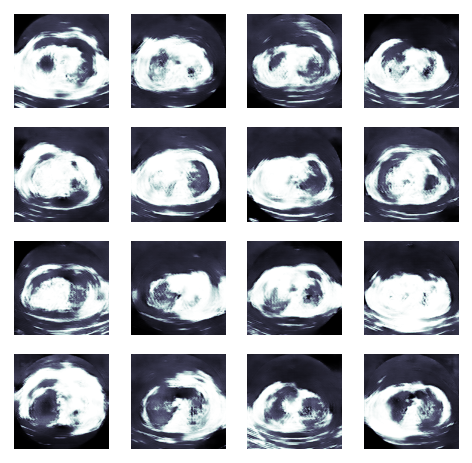

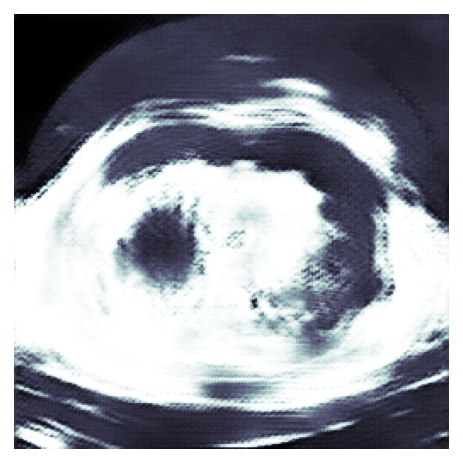

Time for epoch 2 is 621.5035922527313 sec
Time for epoch 3 is 622.6009230613708 sec


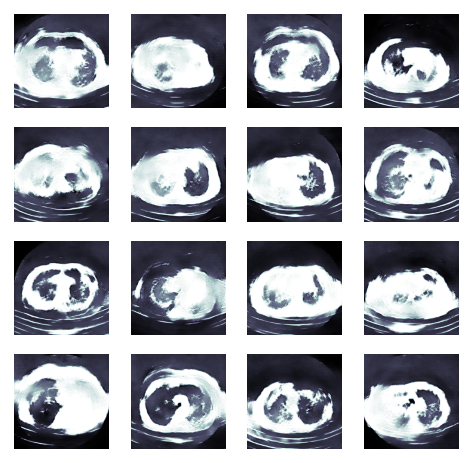

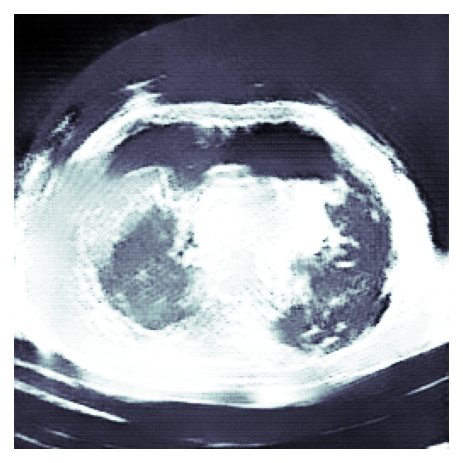

Time for epoch 4 is 617.5270884037018 sec
Time for epoch 5 is 617.4433732032776 sec


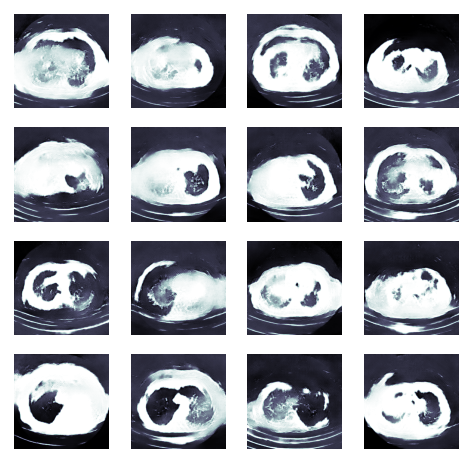

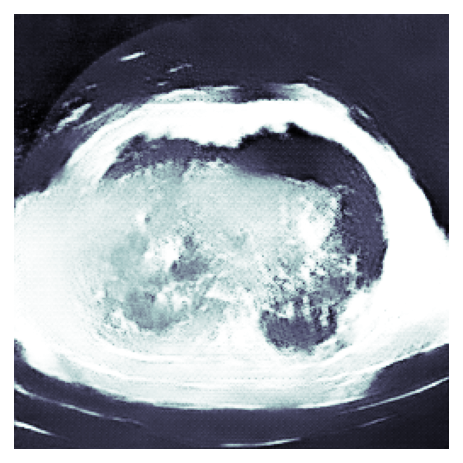

Time for epoch 6 is 617.9059822559357 sec
Time for epoch 7 is 619.4972212314606 sec


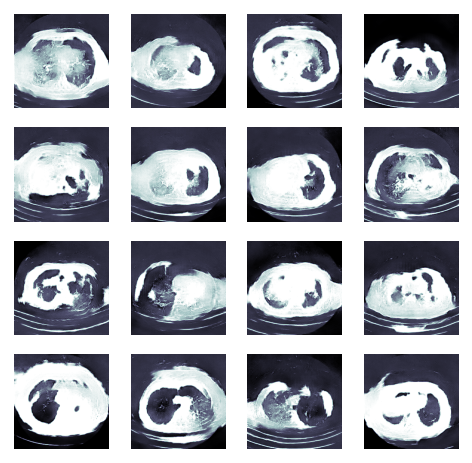

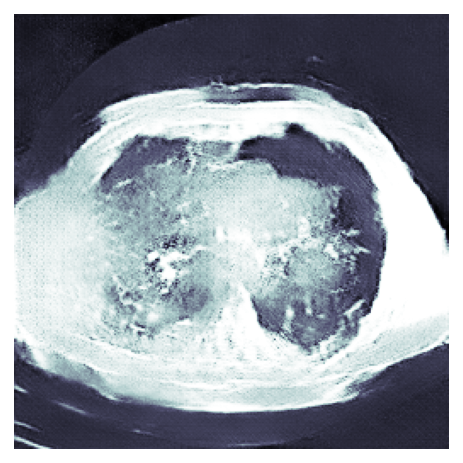

Time for epoch 8 is 620.7084255218506 sec
Time for epoch 9 is 615.049822807312 sec


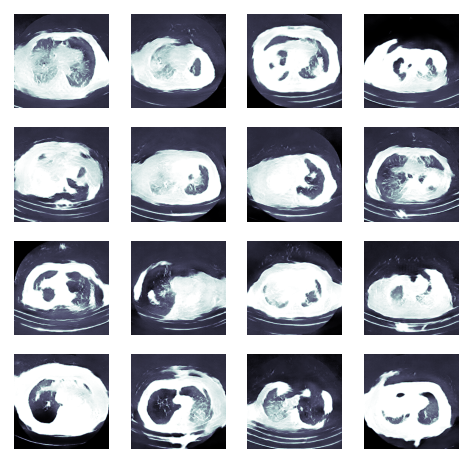

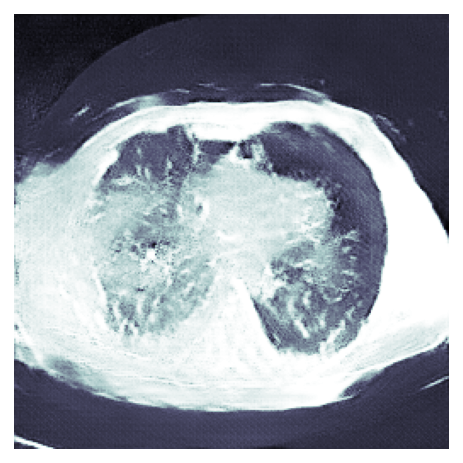

Time for epoch 10 is 616.7973365783691 sec
Time for epoch 11 is 617.7097501754761 sec


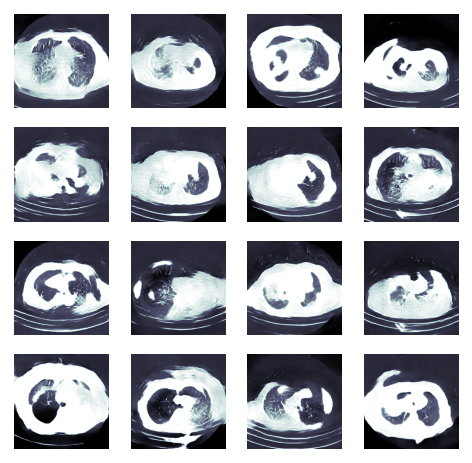

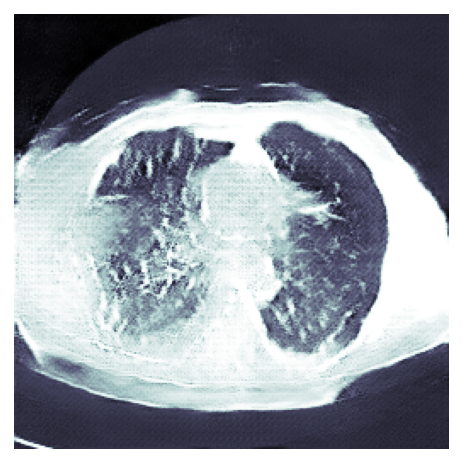

Time for epoch 12 is 621.4178774356842 sec
Time for epoch 13 is 618.7174787521362 sec


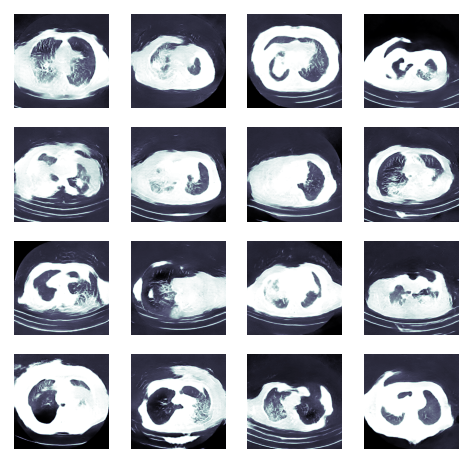

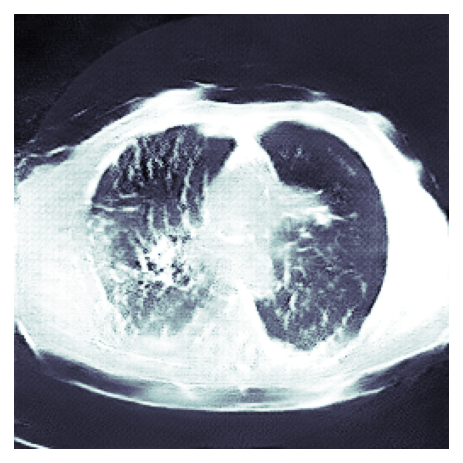

Time for epoch 14 is 618.1216833591461 sec
Time for epoch 15 is 617.629561662674 sec


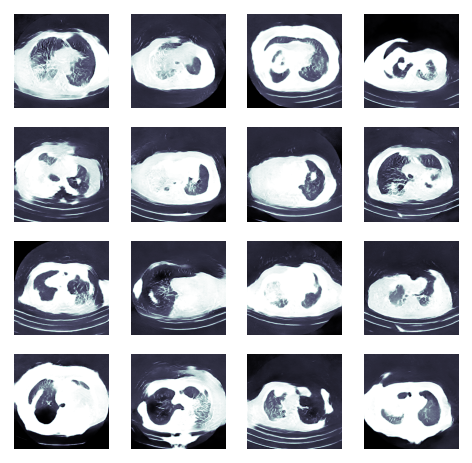

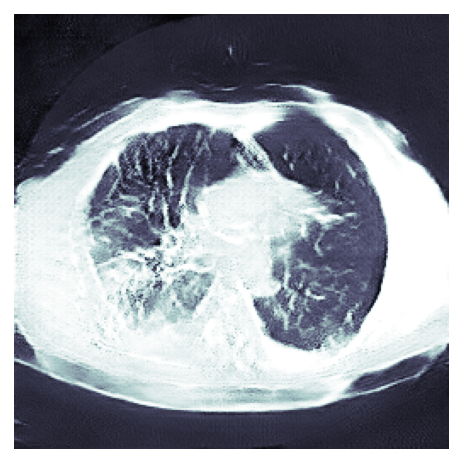

Time for epoch 16 is 620.464704990387 sec
Time for epoch 17 is 619.922732591629 sec


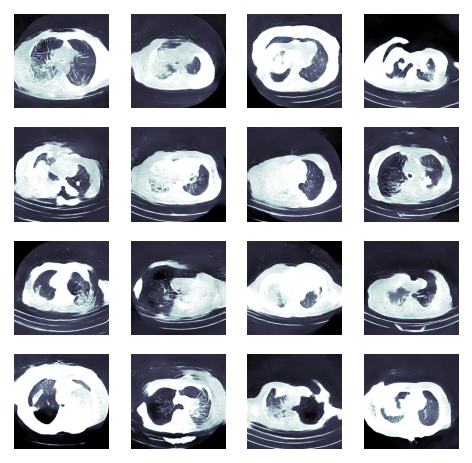

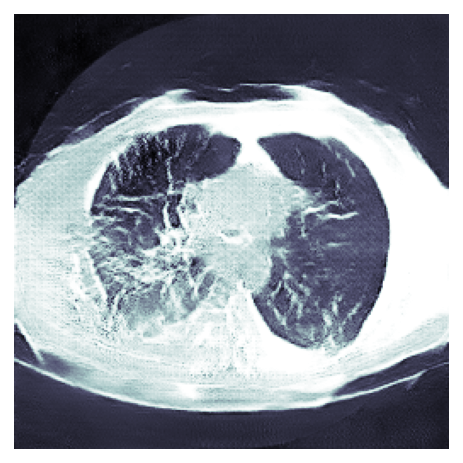

Time for epoch 18 is 612.1195666790009 sec
Time for epoch 19 is 598.6617348194122 sec


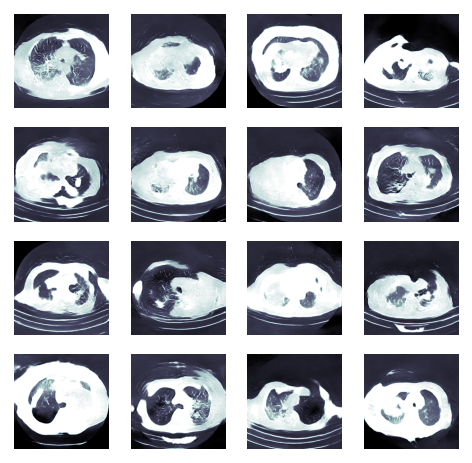

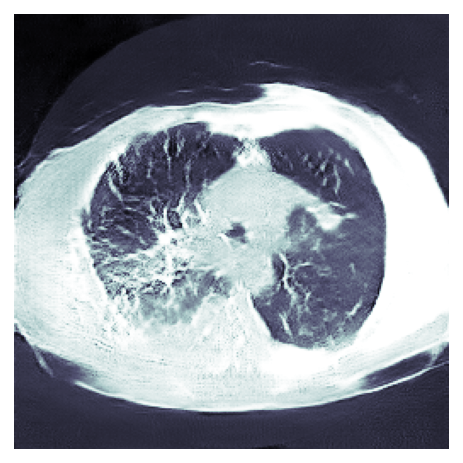

Time for epoch 20 is 589.8749248981476 sec
Time for epoch 21 is 595.8151032924652 sec


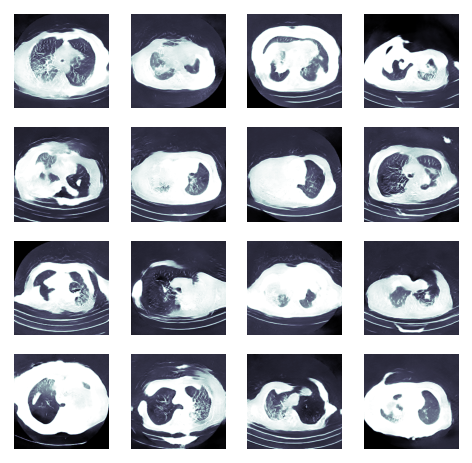

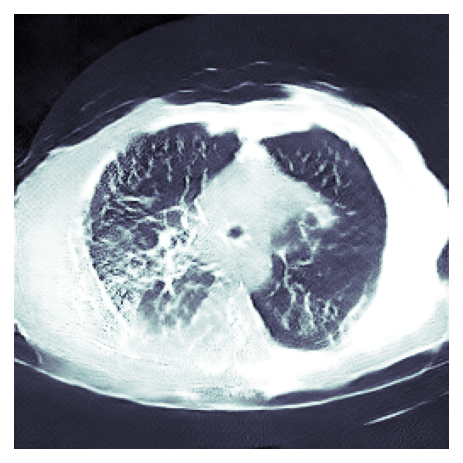

Time for epoch 22 is 590.7723908424377 sec
Time for epoch 23 is 579.7601239681244 sec


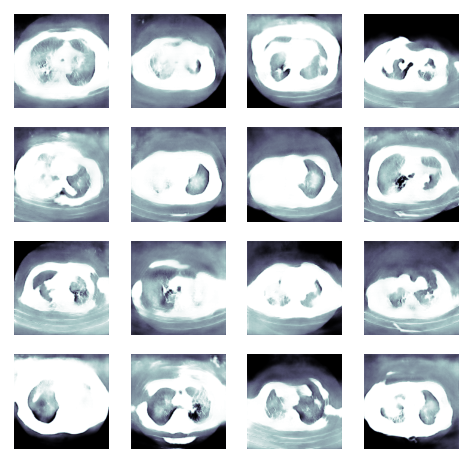

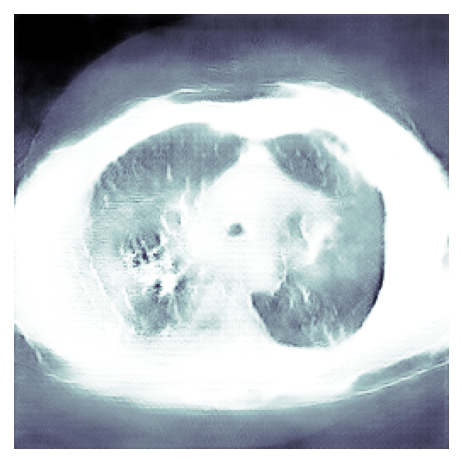

Time for epoch 24 is 580.8003590106964 sec
Time for epoch 25 is 579.5469627380371 sec


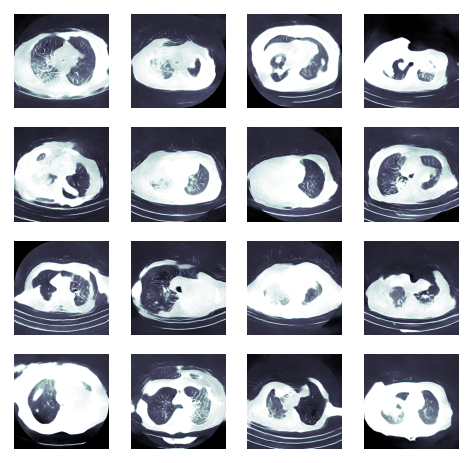

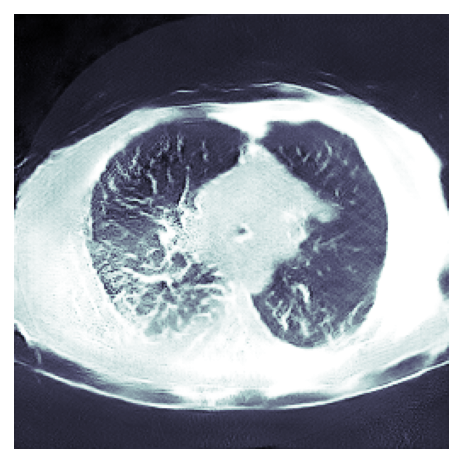

Time for epoch 26 is 580.3015115261078 sec
Time for epoch 27 is 584.1080119609833 sec


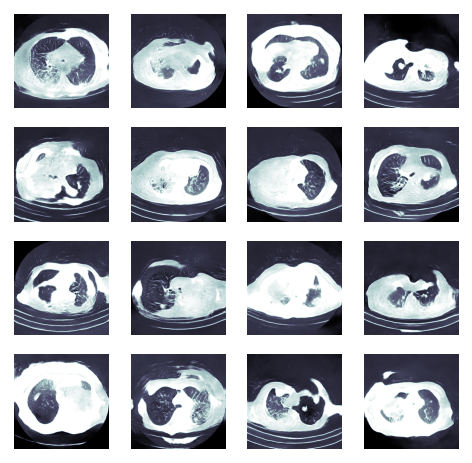

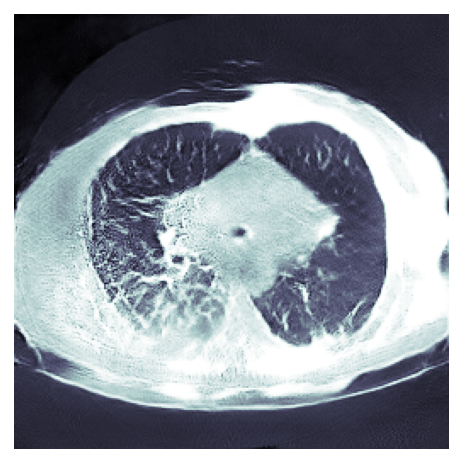

Time for epoch 28 is 580.6170101165771 sec
Time for epoch 29 is 579.8871667385101 sec


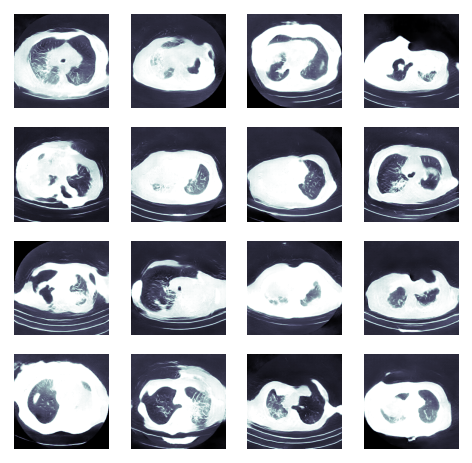

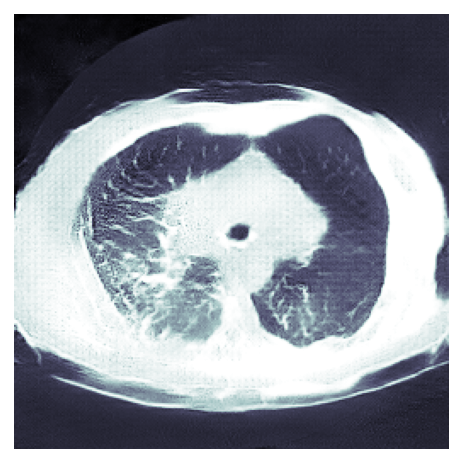

Time for epoch 30 is 580.6627547740936 sec
Time for epoch 31 is 579.7019226551056 sec


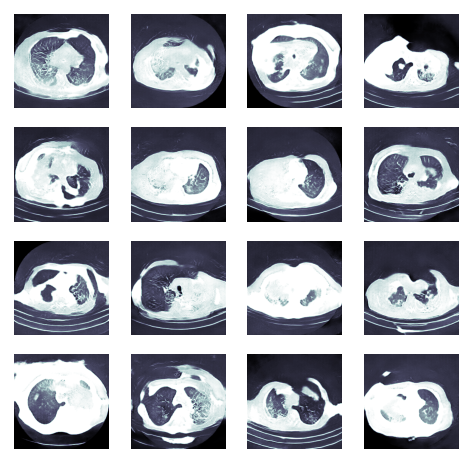

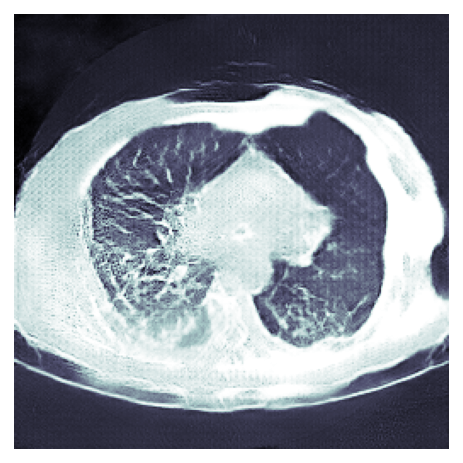

Time for epoch 32 is 617.8379485607147 sec
Time for epoch 33 is 616.9071326255798 sec


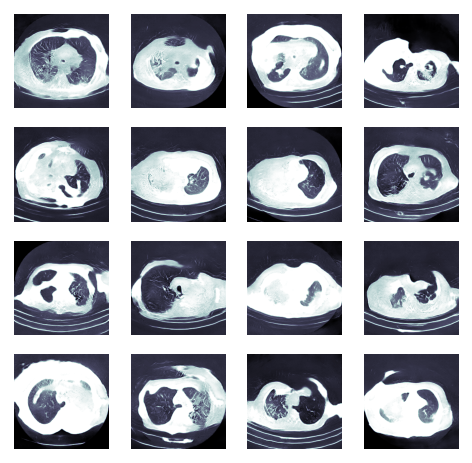

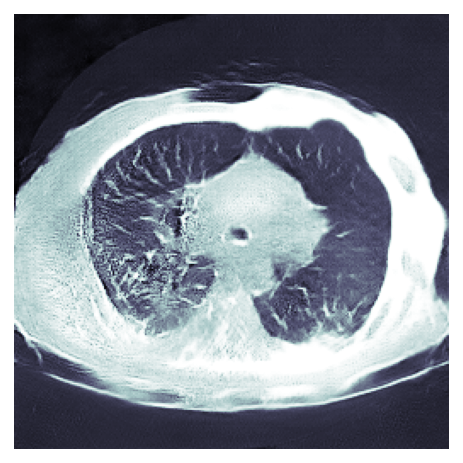

Time for epoch 34 is 616.8068602085114 sec
Time for epoch 35 is 616.9365699291229 sec


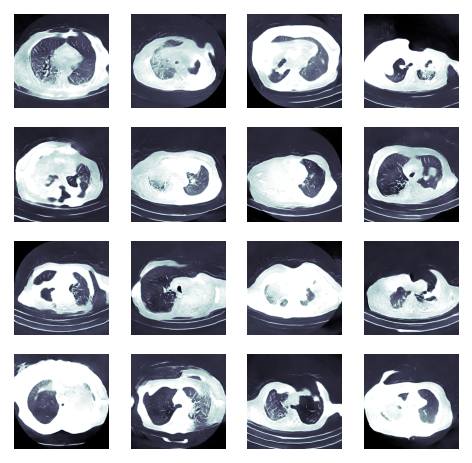

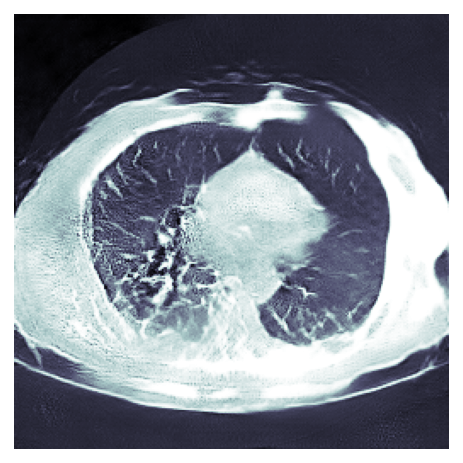

Time for epoch 36 is 617.1449775695801 sec
Time for epoch 37 is 614.9743270874023 sec


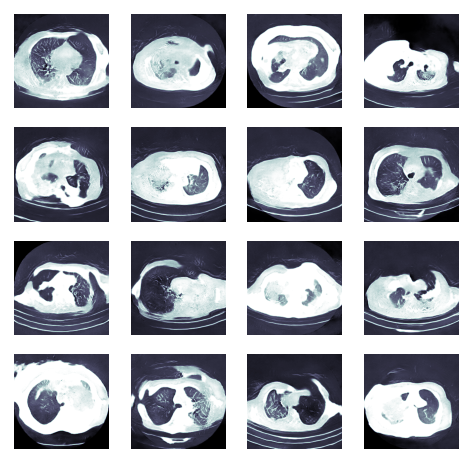

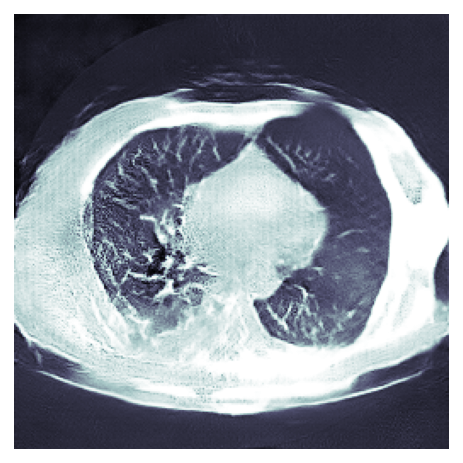

Time for epoch 38 is 614.937460899353 sec
Time for epoch 39 is 613.54736328125 sec


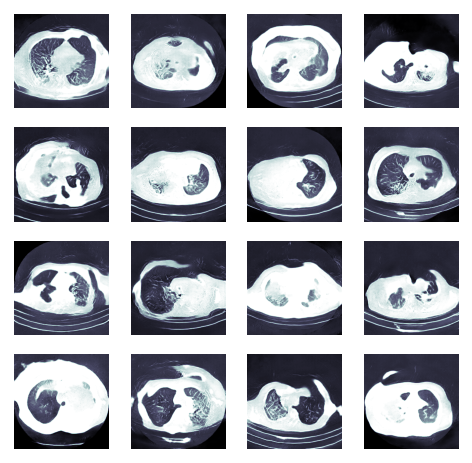

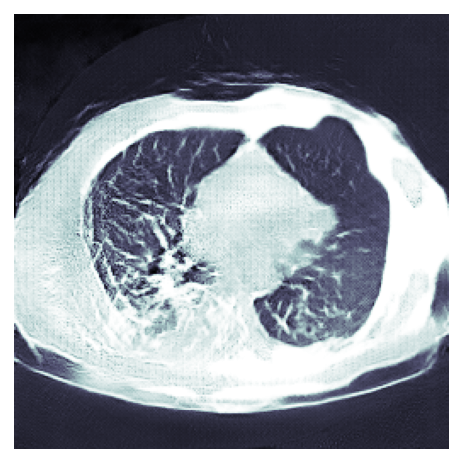

Time for epoch 40 is 615.5833849906921 sec
Time for epoch 41 is 614.9926481246948 sec


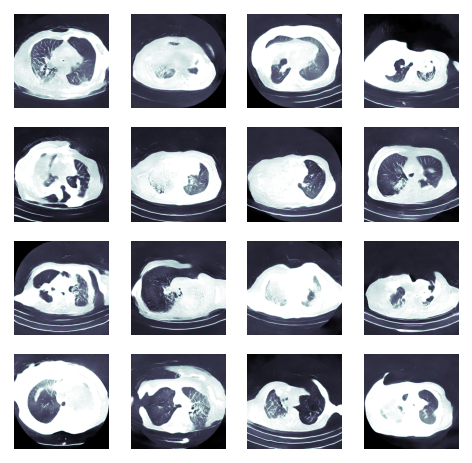

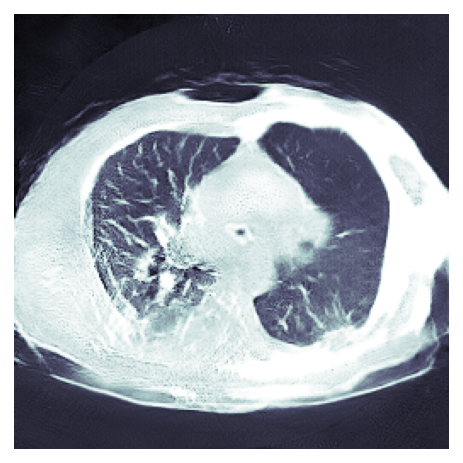

Time for epoch 42 is 613.8370745182037 sec
Time for epoch 43 is 614.9964144229889 sec


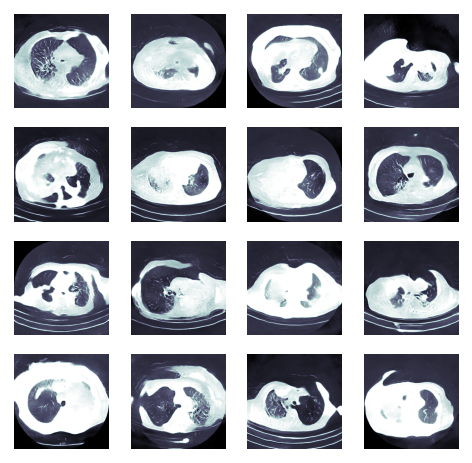

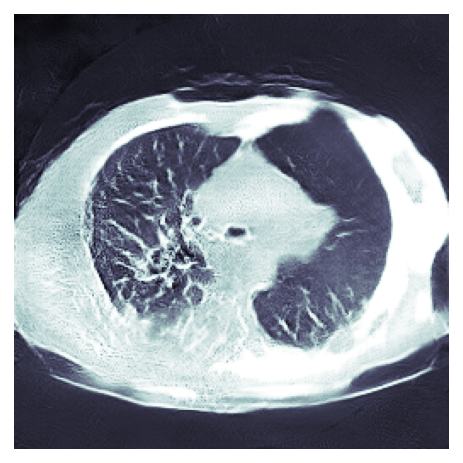

Time for epoch 44 is 615.7067558765411 sec
Time for epoch 45 is 613.9019272327423 sec


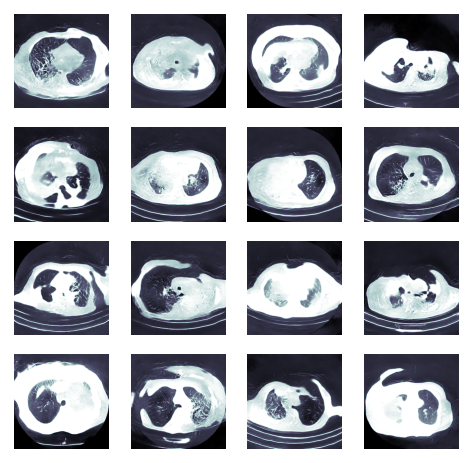

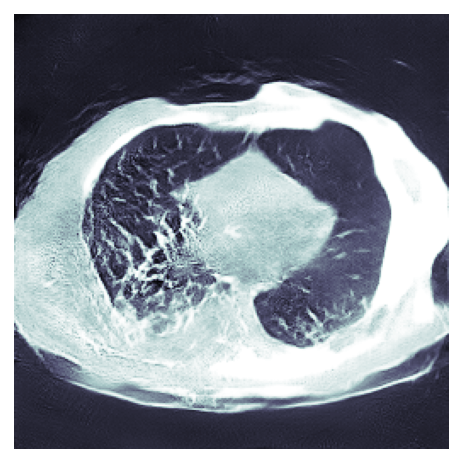

Time for epoch 46 is 614.8179204463959 sec
Time for epoch 47 is 614.0758678913116 sec


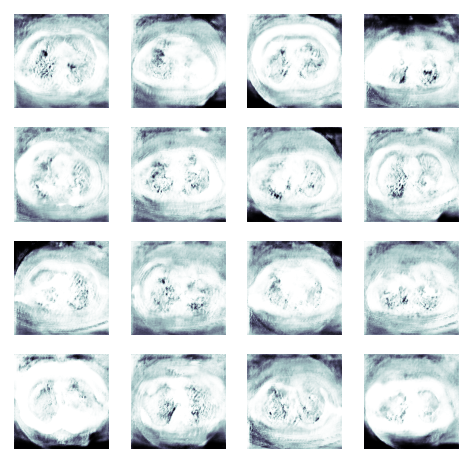

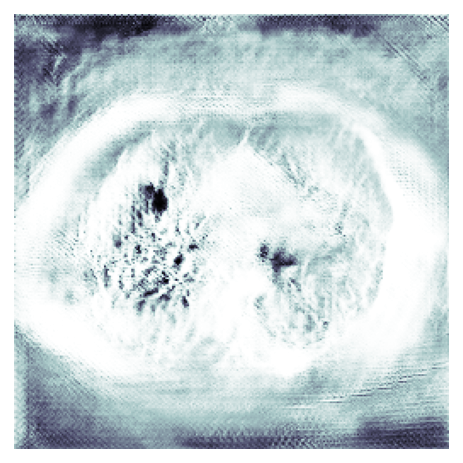

Time for epoch 48 is 614.989773273468 sec
Time for epoch 49 is 612.3197958469391 sec


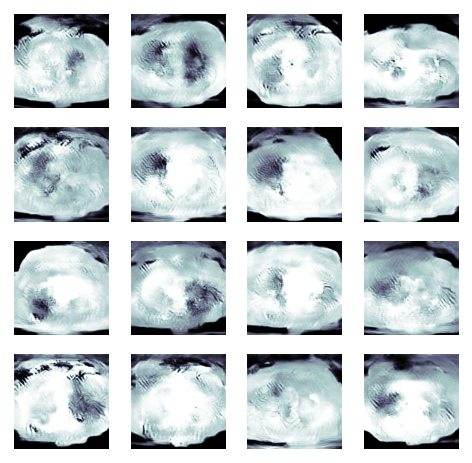

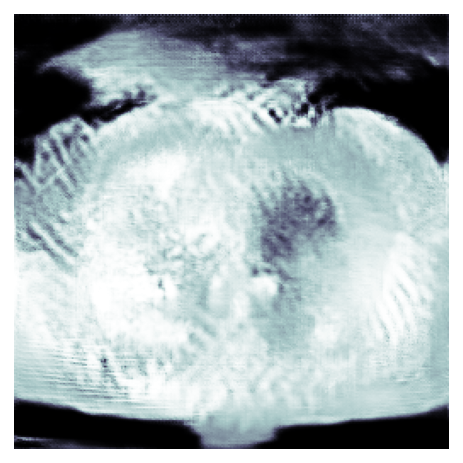

Time for epoch 50 is 615.2515552043915 sec


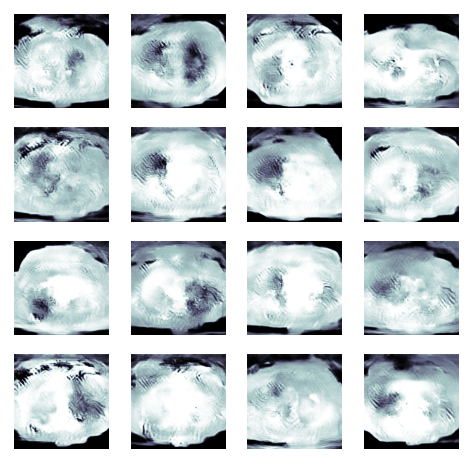

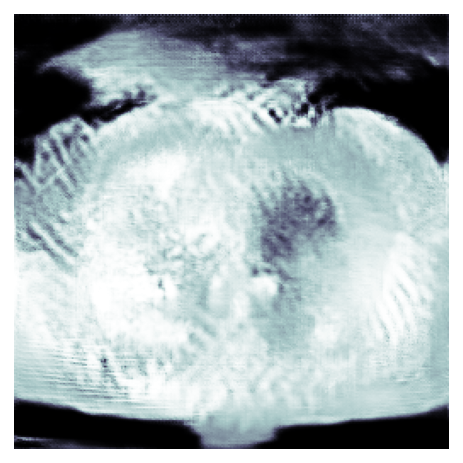

In [21]:
# Train the DCGAN
train(train_set, EPOCHS)

The model seems to be performing rather well. However, epoch 45 or so, we see the model collapse. It starts to generate the same image when provided the same seed. This suggests that the generator has found a combination that always fulls the discriminator. Despite applying different "GAN Hacks" we couldn't stablize the training. 

We do see some success with this basic GAN model in the early training, thus suggesting we might be able to produce better images with a different form of architecture.

---------------
## Load Model Weights
We will use a checkpoint from before the model collapsed to generate some images.

In [23]:
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

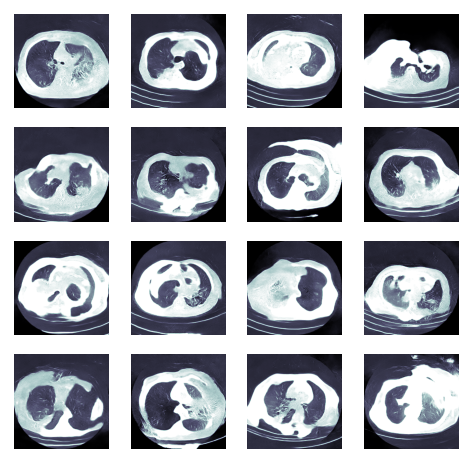

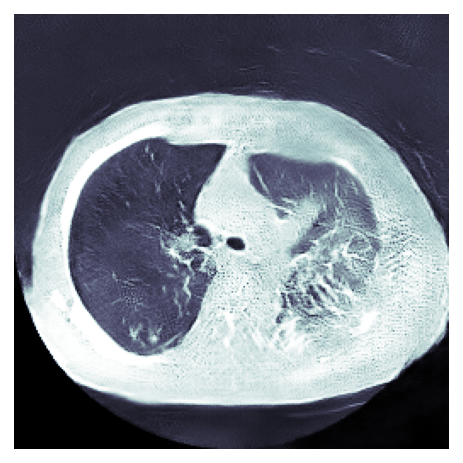

In [24]:
generate_and_save_images(generator, 40, seed)